<a href="https://colab.research.google.com/github/NikitaDash/Global-Terrorism-Analysis-EDA-/blob/main/Global_Terrorism_EDA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Project Name - Global Terrorism Database Analysis**

##**Project Type:** Exploratory Data Analysis
## **Contribution:** Nikita Dash


# **Project Summery:**

The Global Terrorism Database (GTD) is an open-source database which includes information on terrorist attacks from around the world during the timeperiod 1970 through 2017. The GTD includes systematic data on domestic as well as international terrorist incidents that have occurred during this time period and now includes more than 180,000 attacks. The database is maintained by researchers at the National Consortium for the Study of Terrorism and Responses to Terrorism (START), headquartered at the University of Maryland.

The Global Terrorism Exploratory Data Analysis (EDA) project aims to analyze and explore a comprehensive dataset on global terrorism, with the objective of gaining insights into patterns, trends, and factors associated with terrorist activities worldwide. The project will be hosted on GitHub, providing a collaborative platform for researchers, data analysts, and enthusiasts to contribute, discuss, and enhance our understanding of this critical issue.

# **Business Objectives:**
The primary business objective is to conduct an extensive Exploratory Data Analysis (EDA) using the Global Terrorism Dataset, covering the time period from 1970 to 2017. This EDA aims to derive valuable insights into various aspects of global terrorism. The specific objectives and insights sought through this analysis are as follows:

1. **Terror Trend Analysis:**

Identify the top 30 countries with the highest number of terror attacks.
Analyze the success rates of these attacks to understand the effectiveness of terrorist activities in different regions.
2. **Casualty Analysis:**

Conduct a demographic analysis of casualties with a geographical perspective.
Examine casualties caused by different terrorist groups to gain insights into their impact.
3. **Mode of Attacks:**

Perform a comprehensive analysis of the various attack types employed by terrorists.
Compare different attack types used and assess their prevalence among different nationalities.
4. **Target Analysis:**

Thoroughly analyze the various types of targets chosen by terrorists.
Investigate how these target choices vary by region.
5. **Weaponry Analysis:**

Conduct an in-depth analysis of the different types of weaponry used by terrorists, providing insights into the means and tools employed in these acts.
6. **Terrorism Worldwide:**

Analyze and understand the global landscape of terror attacks over the 1970-2017 period, examining geographical distribution and trends.
7. **Terrorism at Home Analysis:**

Analyze terror attacks in India, including a state-wise and city-wise breakdown.
Identify the most active terrorist groups within India and analyze any significant factors contributing to these incidents.
8. **Geo-Scatter Analysis:**

Study the distribution of terrorism across the globe, focusing on the latitude and longitude of the locations of terror attacks in India.
9. **Co-Relation Analysis:**

Conduct an analysis of the top 40 worst terror attacks that occurred between 1978 and 2017.
Visualize this analysis using a heatmap to identify any significant correlations or patterns among these attacks.
The ultimate goal of this EDA is to provide a comprehensive and structured understanding of global terrorism trends, thereby assisting in informed decision-making, policy formulation, and academic research. By exploring and analyzing the Global Terrorism Dataset, this analysis aims to contribute to counter-terrorism efforts, enhance our knowledge of global terrorism, and promote a safer and more secure world.

# **1.Importing Libraries and Loading The data:**

In [1]:
#importing Libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import math
%matplotlib inline
from wordcloud import WordCloud
import folium
import folium.plugins
from matplotlib import animation,rc
import warnings
warnings.filterwarnings('ignore')

In [2]:
#mounting data
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
filepath = '/content/drive/MyDrive/Csv file/Global_Terrorism_Data.csv'
df = pd.read_csv(filepath, encoding = "ISO-8859-1")

In [4]:
#sample of the data
df.head()

,eventid,iyear,imonth,iday,approxdate,extended,resolution,country,country_txt,region,...,addnotes,scite1,scite2,scite3,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY,related
0,197000000001,1970,7,2,NaN,0,NaN,58,Dominican Republic,2,...,NaN,NaN,NaN,NaN,PGIS,0,0,0,0,NaN
1,197000000002,1970,0,0,NaN,0,NaN,130,Mexico,1,...,NaN,NaN,NaN,NaN,PGIS,0,1,1,1,NaN
2,197001000001,1970,1,0,NaN,0,NaN,160,Philippines,5,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
3,197001000002,1970,1,0,NaN,0,NaN,78,Greece,8,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN
4,197001000003,1970,1,0,NaN,0,NaN,101,Japan,4,...,NaN,NaN,NaN,NaN,PGIS,-9,-9,1,1,NaN


In [5]:
#rows and columns of dataset
df.shape

(181691, 135)

In [6]:
#dataset information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 181691 entries, 0 to 181690
Columns: 135 entries, eventid to related
dtypes: float64(55), int64(22), object(58)
memory usage: 187.1+ MB


In [7]:
#duplicated values
df.duplicated().sum()

0

In [8]:
#missing value
df.isnull().sum()

eventid            0
iyear              0
imonth             0
iday               0
approxdate    172452
               ...  
INT_LOG            0
INT_IDEO           0
INT_MISC           0
INT_ANY            0
related       156653
Length: 135, dtype: int64

In [9]:
#percentage of null values of each column
average = df.isnull().sum().sort_values(ascending = False)/len(df)
percentage = round((df.isnull().sum().sort_values(ascending = False)/len(df))*100,2)
percentage

gsubname3           99.99
weapsubtype4_txt    99.96
weapsubtype4        99.96
weaptype4           99.96
weaptype4_txt       99.96
                    ...  
suicide              0.00
success              0.00
crit3                0.00
property             0.00
eventid              0.00
Length: 135, dtype: float64

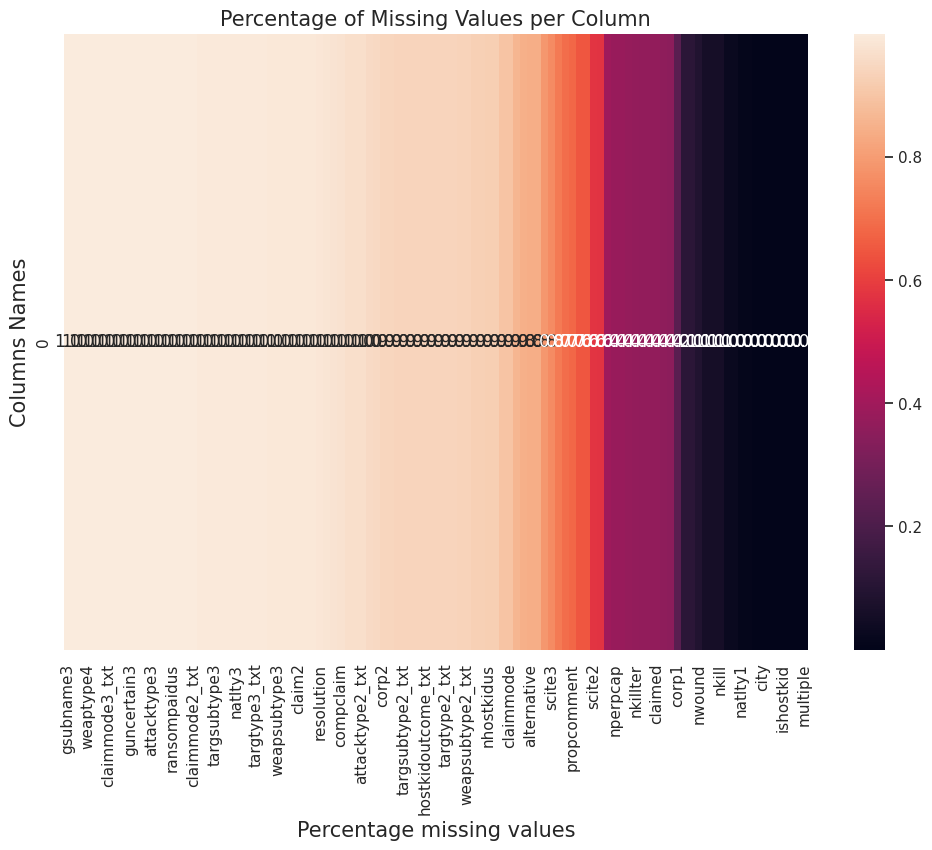

In [10]:
# Create a heatmap
plt.figure(figsize=(12, 8))
sns.set(font_scale=1)
sns.heatmap(average[average > 0.0].to_frame().T, annot=True, fmt=".1f", cbar=True)

plt.title("Percentage of Missing Values per Column", fontsize=15)
plt.xlabel("Percentage missing values", fontsize=15)
plt.ylabel("Columns Names", fontsize=15)

plt.show()


## **About the dataset:**
* The dataset has 181691 Rows & 135 columns.
* Most of the columns have Missing values approximately 99%
* There are no duplicate values.


# **2. Variable understanding:**

In [11]:
#columns of the dataset
df.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'approxdate', 'extended',
       'resolution', 'country', 'country_txt', 'region',
       ...
       'addnotes', 'scite1', 'scite2', 'scite3', 'dbsource', 'INT_LOG',
       'INT_IDEO', 'INT_MISC', 'INT_ANY', 'related'],
      dtype='object', length=135)

In [12]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
eventid,181691.0,2.002705e+11,1.325957e+09,1.970000e+11,1.991021e+11,2.009022e+11,2.014081e+11,2.017123e+11
iyear,181691.0,2.002639e+03,1.325943e+01,1.970000e+03,1.991000e+03,2.009000e+03,2.014000e+03,2.017000e+03
imonth,181691.0,6.467277e+00,3.388303e+00,0.000000e+00,4.000000e+00,6.000000e+00,9.000000e+00,1.200000e+01
iday,181691.0,1.550564e+01,8.814045e+00,0.000000e+00,8.000000e+00,1.500000e+01,2.300000e+01,3.100000e+01
extended,181691.0,4.534622e-02,2.080629e-01,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
...,...,...,...,...,...,...,...,...
nreleased,10400.0,-2.901827e+01,6.572012e+01,-9.900000e+01,-9.900000e+01,0.000000e+00,1.000000e+00,2.769000e+03
INT_LOG,181691.0,-4.543731e+00,4.543547e+00,-9.000000e+00,-9.000000e+00,-9.000000e+00,0.000000e+00,1.000000e+00
INT_IDEO,181691.0,-4.464398e+00,4.637152e+00,-9.000000e+00,-9.000000e+00,-9.000000e+00,0.000000e+00,1.000000e+00
INT_MISC,181691.0,9.000996e-02,5.684573e-01,-9.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00


# **Variables Description**
Ledger of the most important variables in the dataset considered for this EDA includes -

Date (Year, Month, Day) ➡️ Column that contains the chronological record of the attack.

Latitude/Longitude ➡️ The column containing the Geographical co-ordinates with latitude and longitude data, of where the attack/incident occured.

Country ➡️ The Country/Location where the attack originated.

Region ➡️ The geographical region (≠ continent) where the attack occurred.

Gang_name ➡️ The name of the Terrorist Group who were responsible for the said incident.

Target ➡️ The asset on which the attack was directed towards.

Kills ➡️ Casualities of victims due to the terrorist attack.

nwound ➡️ Number of wounded victims due to the terrorist attack.

Weapon_type ➡️ The choice of Weaponary, used for the attack.

Attack ➡️ The type of attack performed.

Nationality of Victim ➡️ The origin country of the vicitim who was attacked.

ishostkid ➡️ Is the hostage taken by terrorists a kid.

# **3. Data Wrangling**

In [13]:
#create a copy of the data
data = df.copy()

In [14]:
#columns having 20% missingvalues
drop_column = list(average[average > 0.20].index.values)
drop_column

['gsubname3',
 'weapsubtype4_txt',
 'weapsubtype4',
 'weaptype4',
 'weaptype4_txt',
 'claimmode3',
 'claimmode3_txt',
 'gsubname2',
 'claim3',
 'guncertain3',
 'gname3',
 'divert',
 'attacktype3',
 'attacktype3_txt',
 'ransomnote',
 'ransompaidus',
 'ransomamtus',
 'claimmode2',
 'claimmode2_txt',
 'ransompaid',
 'corp3',
 'targsubtype3',
 'targsubtype3_txt',
 'natlty3_txt',
 'natlty3',
 'target3',
 'targtype3',
 'targtype3_txt',
 'ransomamt',
 'weapsubtype3_txt',
 'weapsubtype3',
 'weaptype3_txt',
 'weaptype3',
 'claim2',
 'guncertain2',
 'gname2',
 'resolution',
 'kidhijcountry',
 'nhours',
 'compclaim',
 'gsubname',
 'attacktype2',
 'attacktype2_txt',
 'ndays',
 'approxdate',
 'corp2',
 'nreleased',
 'targsubtype2',
 'targsubtype2_txt',
 'natlty2',
 'natlty2_txt',
 'hostkidoutcome_txt',
 'hostkidoutcome',
 'target2',
 'targtype2_txt',
 'targtype2',
 'weapsubtype2',
 'weapsubtype2_txt',
 'weaptype2',
 'weaptype2_txt',
 'nhostkidus',
 'nhostkid',
 'claimmode_txt',
 'claimmode',
 'rela

In [15]:
#dropping missing values column from the data
data.drop(drop_column,inplace=True,axis=1)


In [16]:
data.columns

Index(['eventid', 'iyear', 'imonth', 'iday', 'extended', 'country',
       'country_txt', 'region', 'region_txt', 'provstate', 'city', 'latitude',
       'longitude', 'specificity', 'vicinity', 'crit1', 'crit2', 'crit3',
       'doubtterr', 'multiple', 'success', 'suicide', 'attacktype1',
       'attacktype1_txt', 'targtype1', 'targtype1_txt', 'targsubtype1',
       'targsubtype1_txt', 'target1', 'natlty1', 'natlty1_txt', 'gname',
       'guncertain1', 'individual', 'weaptype1', 'weaptype1_txt',
       'weapsubtype1', 'weapsubtype1_txt', 'nkill', 'nwound', 'property',
       'ishostkid', 'dbsource', 'INT_LOG', 'INT_IDEO', 'INT_MISC', 'INT_ANY'],
      dtype='object')

In [17]:
data.shape

(181691, 47)

In [18]:
#checking missing values for remaining columns
missing_values = data.isnull().sum().sort_values(ascending=False)/len(data)
missing_percentages = missing_values * 100
missing_percentages


weapsubtype1        11.430396
weapsubtype1_txt    11.430396
nwound               8.977330
targsubtype1_txt     5.709144
targsubtype1         5.709144
nkill                5.676120
longitude            2.508104
latitude             2.507554
natlty1              0.858050
natlty1_txt          0.858050
target1              0.350045
city                 0.238867
provstate            0.231712
guncertain1          0.209146
ishostkid            0.097969
specificity          0.003302
doubtterr            0.000550
multiple             0.000550
individual           0.000000
INT_MISC             0.000000
gname                0.000000
weaptype1_txt        0.000000
weaptype1            0.000000
property             0.000000
INT_IDEO             0.000000
INT_LOG              0.000000
dbsource             0.000000
eventid              0.000000
attacktype1_txt      0.000000
targtype1_txt        0.000000
targtype1            0.000000
imonth               0.000000
iday                 0.000000
extended  

In [19]:
#renaming the columns
data.rename(columns= {'iyear':'Year', 'imonth':'month','iday':'day','country_txt':'Country','weaptype1_txt':'Weapontype',
                      'region_txt':'Region','provstate':'State','attacktype1_txt':'Attacktype','targtype1_txt':'Target_type',
                      'targetsubtype1_txt':'Target_subtype','gname':'Gang_name','nkill':'kills','nwound':'Wounds'},inplace=True)
data.columns

Index(['eventid', 'Year', 'month', 'day', 'extended', 'country', 'Country',
       'region', 'Region', 'State', 'city', 'latitude', 'longitude',
       'specificity', 'vicinity', 'crit1', 'crit2', 'crit3', 'doubtterr',
       'multiple', 'success', 'suicide', 'attacktype1', 'Attacktype',
       'targtype1', 'Target_type', 'targsubtype1', 'targsubtype1_txt',
       'target1', 'natlty1', 'natlty1_txt', 'Gang_name', 'guncertain1',
       'individual', 'weaptype1', 'Weapontype', 'weapsubtype1',
       'weapsubtype1_txt', 'kills', 'Wounds', 'property', 'ishostkid',
       'dbsource', 'INT_LOG', 'INT_IDEO', 'INT_MISC', 'INT_ANY'],
      dtype='object')

In [20]:
#Filling the Nan valus
data['State'] = data['State'].fillna('Unknown')
data['city'] = data['city'].fillna('Unknown')
data['Target_type'] = data['Target_type'].fillna('others')
data['kills'] = data['kills'].fillna('0')
data['Wounds'] = data['Wounds'].fillna('0')


In [21]:
data.head()

,eventid,Year,month,day,extended,country,Country,region,Region,State,...,weapsubtype1_txt,kills,Wounds,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,197000000001,1970,7,2,0,58,Dominican Republic,2,Central America & Caribbean,Unknown,...,NaN,1.0,0.0,0,0.0,PGIS,0,0,0,0
1,197000000002,1970,0,0,0,130,Mexico,1,North America,Federal,...,NaN,0.0,0.0,0,1.0,PGIS,0,1,1,1
2,197001000001,1970,1,0,0,160,Philippines,5,Southeast Asia,Tarlac,...,NaN,1.0,0.0,0,0.0,PGIS,-9,-9,1,1
3,197001000002,1970,1,0,0,78,Greece,8,Western Europe,Attica,...,Unknown Explosive Type,0,0,1,0.0,PGIS,-9,-9,1,1
4,197001000003,1970,1,0,0,101,Japan,4,East Asia,Fukouka,...,NaN,0,0,1,0.0,PGIS,-9,-9,1,1


## **Insights:**

Based on the initial Sanity checks We uncovered that a few of the columns had inconsistent or missing data, hence logically we decided to drop the unimportant columns unilaterally containing missing values which exceeded 20% of total values from our dataset.

Then we explored the remaining columns data for missing values again & tried to fill them up as possible.Lastly, We have filtered the following set of columns for our analysis:

> Year, Month, Country, Region, State, City, Kids as Hostage, Successs, Nationality of victim, Attack type, Target type, Weapon type, Kills, nwound, Gang name.

#**4.Data Visualisation**

## **General Analysis**:

In [22]:
print('Most attacked Country:', data['Country'].value_counts().idxmax())
print('Most attacked City:', data['city'].value_counts().index[1])
print('Most attacked Region:', data['region'].value_counts().idxmax())
print('Most attacked Year:', data['Year'].value_counts().idxmax())
print('Most attacked month:',data['month'].value_counts().idxmax())
print("Most attacked group:",data['Gang_name'].value_counts().index[1])
print('Most attacked types:', data['Attacktype'].value_counts().idxmax())


Most attacked Country: Iraq
Most attacked City: Baghdad
Most attacked Region: 10
Most attacked Year: 2014
Most attacked month: 5
Most attacked group: Taliban
Most attacked types: Bombing/Explosion


## **Country that are most affected by terrorist**

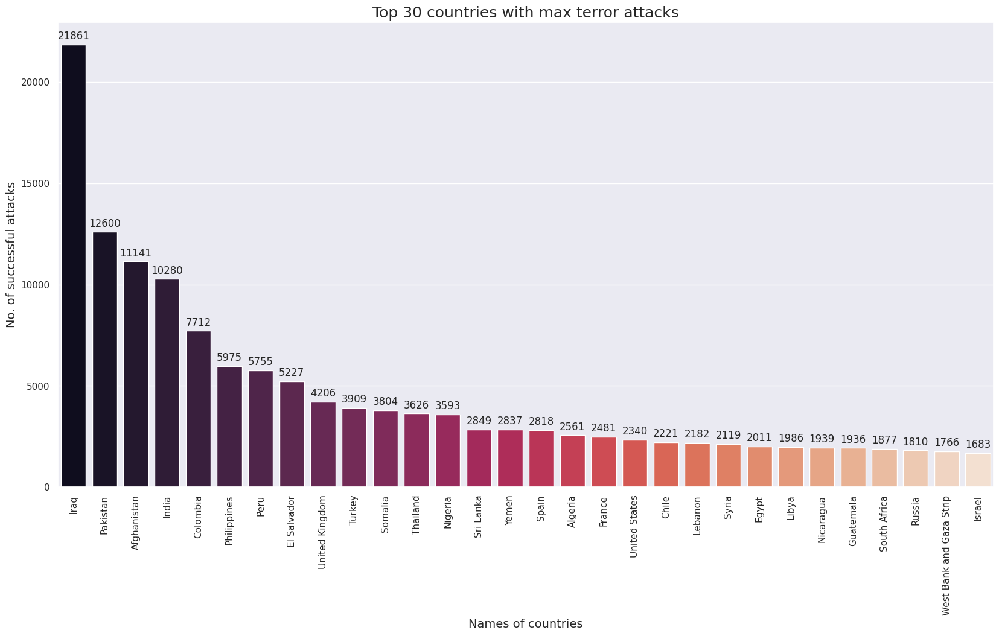

In [23]:
#visualising country that are affected by terror
group = data.groupby('Country')
total_sus = group['success'].sum()
tot_attack = pd.DataFrame(total_sus).reset_index()
tot_attack.sort_values(by = 'success',ascending = False, inplace = True)
tot_attack = tot_attack.head(30)

#for visualisation
plt.figure(figsize =(20,10))

a = sns.barplot(data= tot_attack, x ='Country', y='success', palette = 'rocket')

plt.xticks(rotation=90)
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)

a.set_title('Top 30 countries with max terror attacks',fontsize = 18)
a.set_ylabel('No. of successful attacks', fontsize=14)
a.set_xlabel('Names of countries', fontsize= 14)
for i in a.patches:
  a.annotate(format(i.get_height(), '.0f'), (i.get_x() + i.get_width() / 2., i.get_height()), ha = 'center', va = 'center', xytext = (0, 10), textcoords = 'offset points')

plt.show()

## **Insights:**
Based on the plot above some of the statistics that can be determined include -

* Iraq with 21861 attacks Ranked 1st - as the most terrorised country on the planet.

* Pakistan with 12600 attacks Ranked 2nd.

* Afghanistan with 11141 attacks Ranked 3rd, These are the top three contries affected by the most number of terrorist attacks globally.

* India closely follows with 10280 attacks at the fourth spot for the most number of terrorist attacks globally.

##**Highest terrorist attack year wise:**

<Axes: xlabel='Year', ylabel='count'>

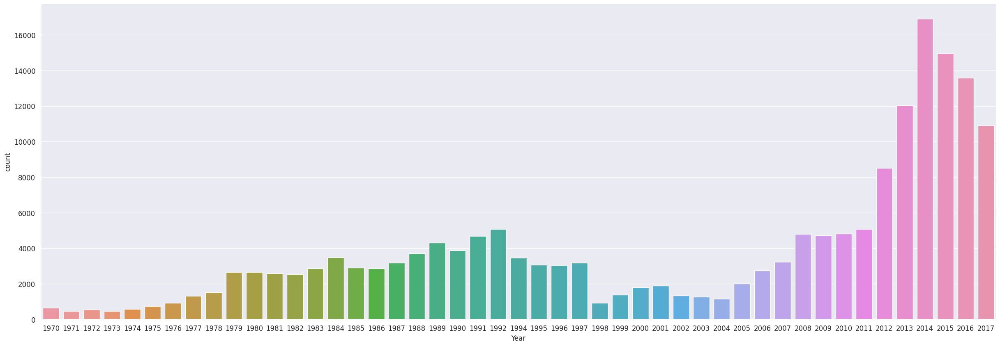

In [24]:
plt.figure(figsize =(30,10))
sns.countplot(x ='Year', data=data)

* There is significant increase in terrorist attack from 1970 to 2017.
* In 2014 there are maximum attacks across the world.

## **Building a map for 2014 attacks**

In [25]:
filterYear = data['Year'] == 2014
filterData = data[filterYear] # filter data
# filterData.info()
reqFilterData = filterData.loc[:,'city':'longitude'] #We are getting the required fields
reqFilterData = reqFilterData.dropna() # drop NaN values in latitude and longitude
reqFilterDataList = reqFilterData.values.tolist()
# reqFilterDataList
map = folium.Map(location = [0, 30], tiles='CartoDB positron', zoom_start=2)
# clustered marker
markerCluster = folium.plugins.MarkerCluster().add_to(map)
for point in range(0, len(reqFilterDataList)):
    folium.Marker(location=[reqFilterDataList[point][1],reqFilterDataList[point][2]],
                  popup = reqFilterDataList[point][0]).add_to(markerCluster)
map

## **Worldwide Demography Analysis Of Casualities due to terrorist attacks**

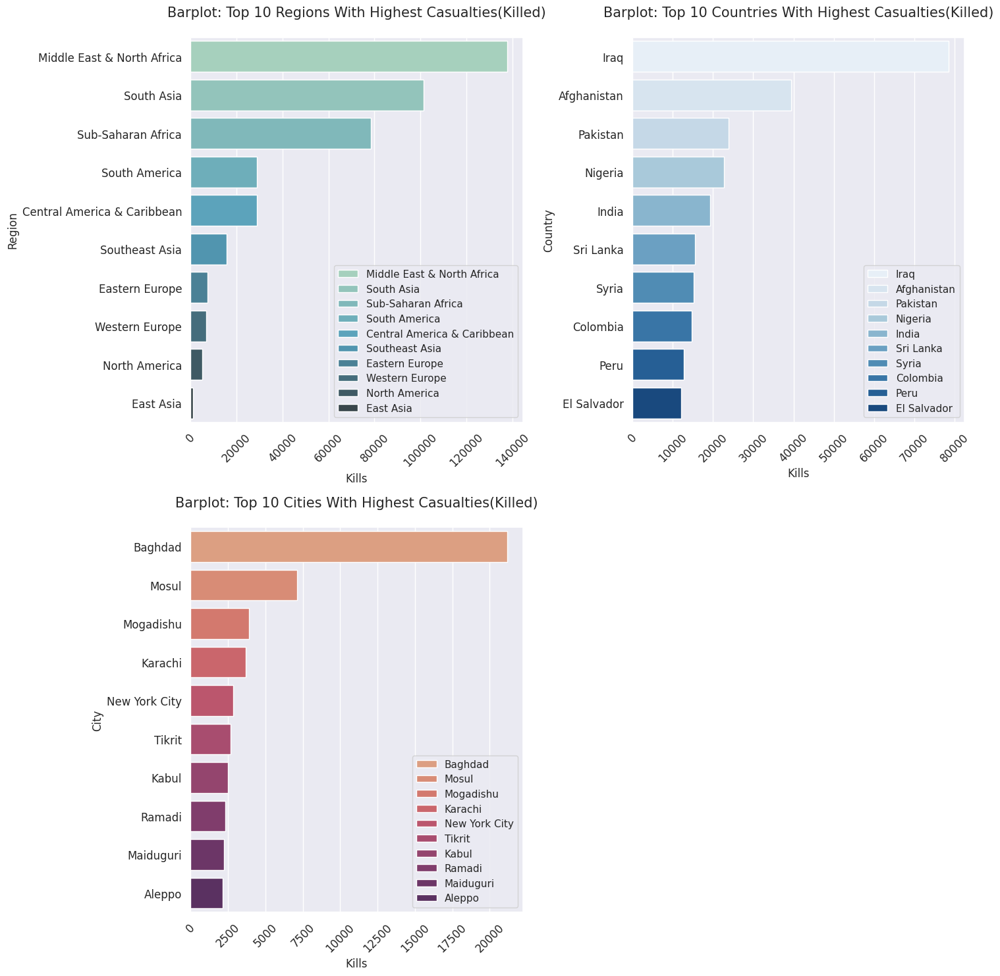

In [26]:
data['kills'] = pd.to_numeric(data['kills'], errors='coerce')
# Chart - 2 visualization code
#Prepare dataframes
top_countries = data.groupby('Country')['kills'].sum().nlargest(10)
top_countries = top_countries.drop('Unknown', errors='ignore')

top_regions = data.groupby('Region')['kills'].sum().nlargest(10)
top_regions = top_regions.drop('Unknown', errors='ignore')

top_cities = data.groupby('city')['kills'].sum().nlargest(11)
top_cities = top_cities.drop('Unknown', errors='ignore')

# Add margins between subplots
plt.subplots_adjust(left=0.1, right=0.9, bottom=0.1, top=0.9, wspace=0.4, hspace=0.4)

# Plot Subplot of Countries and add respective lables and tiltes
plt.subplot(2,2,1)
sns.barplot(y=top_regions.index, x=top_regions.values, label=top_regions.index, palette = 'GnBu_d', orient = 'h')
plt.xlabel('Kills')
plt.ylabel('Region')
plt.title('Barplot: Top 10 Regions With Highest Casualties(Killed)\n',fontsize = 15)
plt.xticks(rotation=45)
plt.legend()


# Plot Subplot of States and add respective lables and tiltes
plt.subplot(2,2,2)
sns.barplot(y=top_countries.index, x=top_countries.values, label=top_countries.index, palette = 'Blues', orient = 'h')
plt.xlabel('Kills')
plt.ylabel('Country')
plt.title('Barplot: Top 10 Countries With Highest Casualties(Killed)\n',fontsize = 15)
plt.xticks(rotation = 45)
plt.legend()


# Plot Subplot of Cities and add respective lables and tiltes
plt.subplot(2,2,3)
sns.barplot(y=top_cities.index, x=top_cities.values,label=top_cities.index, palette = 'flare', orient = 'h')
plt.xlabel('Kills')
plt.ylabel('City')
plt.title('Barplot: Top 10 Cities With Highest Casualties(Killed)\n', fontsize = 15)
plt.xticks(rotation=45)
plt.legend()

# Set plot size
plt.gcf().set_size_inches(15,15)
plt.tight_layout()

# Display plot
plt.show()



In [27]:
total_kills = data['kills'].sum()
print(f'Total no. of kills from 1972 to 2017 are {int(total_kills)}')

Total no. of kills from 1972 to 2017 are 411868


## **Insights:**
* Among the top 10 regions, the Middle East and North Africa have the highest number with 137642 of casualties to be specific, while East Asia has the fewest ie 1152.

* Among the top 10 countries, Iqar has the most casualties with 78589 to be specific, while El Salvador has the fewest ie 12053 only.

* Among the top 10 cities, Baghdad has the highest number of casualties with 21151 to be specific, while Aleppo has the lowest ie 2125.

From the above data we can also conclude the total no. of worldwide casualities caused by terrorist attacks form 1972 to 2017 were 411868.

# **Demographic Analysis of Casualities By Terrorist Group:**

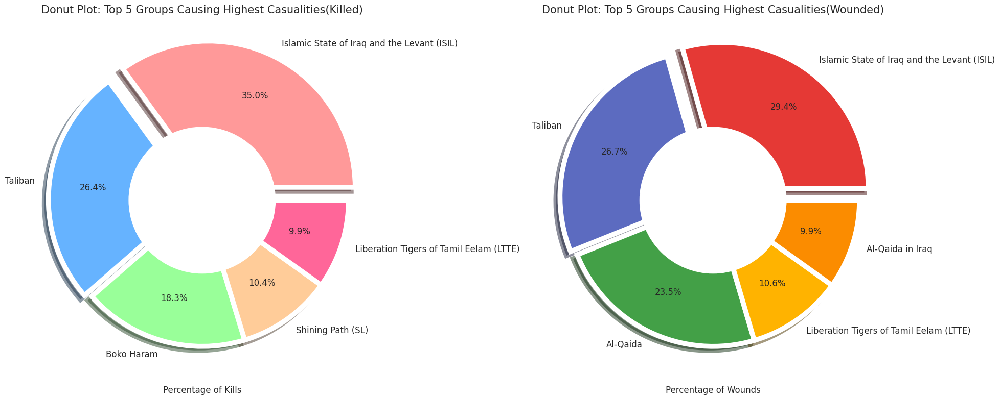

In [28]:
data['Wounds'] = pd.to_numeric(data['Wounds'], errors='coerce')
# Prepare dataframe
most_kills = data.groupby('Gang_name')['kills'].sum().sort_values(ascending=False)
most_kills = most_kills.drop('Unknown')

most_wound = data.groupby('Gang_name')['Wounds'].sum().sort_values(ascending=False)
most_wound = most_wound.drop('Unknown')

# Plot Pieplot for most_kills
plt.figure(figsize=(20, 8))
colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99', '#ff6699']
plt.subplot(1, 2, 1)
plt.pie(most_kills.head(), labels=most_kills.head().index, autopct='%1.1f%%', shadow=True, explode=(0.1, 0.05, 0, 0, 0),
        wedgeprops={'linewidth': 7, 'edgecolor': 'white'}, colors=colors, pctdistance=0.7)

my_circle = plt.Circle((0, 0), 0.5, color='white')
plt.gcf().gca().add_artist(my_circle)

# Add title and labels for most_kills plot
plt.title('Donut Plot: Top 5 Groups Causing Highest Casualities(Killed)', fontsize= 15)
plt.xlabel('Percentage of Kills', fontsize=12)

# Plot Pieplot for most_wound
colors_diff = ['#E53935', '#5C6BC0', '#43A047', '#FFB300', '#FB8C00']
plt.subplot(1, 2, 2)
plt.pie(most_wound.head(), labels=most_wound.head().index, autopct='%1.1f%%', shadow=True, explode=(0.1, 0.05, 0, 0, 0),
        wedgeprops={'linewidth': 7, 'edgecolor': 'white'}, colors=colors_diff, pctdistance=0.7)


my_circle = plt.Circle((0, 0), 0.5, color='white')
plt.gcf().gca().add_artist(my_circle)

# Add title and labels for most_wound plot
plt.title('Donut Plot: Top 5 Groups Causing Highest Casualities(Wounded)', fontsize= 15)
plt.xlabel('Percentage of Wounds', fontsize=12)

# Adjust spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()

## **Insights:**
* Among the top 5 terrorist groups Islamic States of Iraq and the Levant(ISIL) caused the most casualties which comprised of 35% of the overall casualities.

* Among the top 5 terrorist groups Islamic State of Iraq the Levant(ISIL) caused the least casualties at 9.9%.

* Among the top 5 terrorist groups, attacks caused by the Islamic State of Iraq and the Levant resulted in the most number of wounded individuals approximately 29.5%.

Among the top 5 terrorist groups Al-Qaida in Iraq caused the least number of wounded individuals at 9.9%.

# **KDE plot of Demographic Comparison Of Casualities Over The Year:**

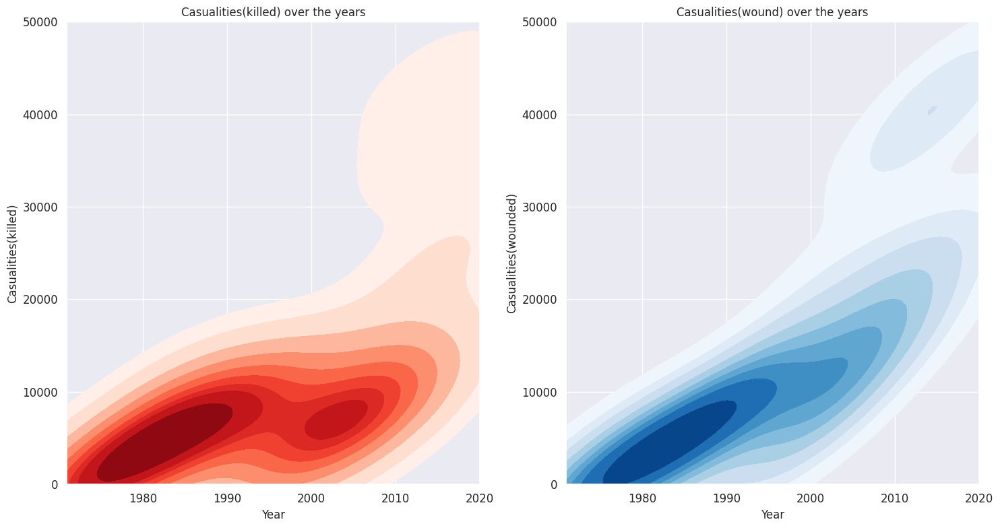

In [29]:
year_kills = data.groupby('Year')['kills'].sum()
year_kills = year_kills.drop('Unknown', errors = 'ignore')

year_wounds = data.groupby('Year')['Wounds'].sum()
year_wounds = year_wounds.drop('Unknown', errors = 'ignore')

#set up the figure with two subplot
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (15,8))

#plot the kde plot year_kills
sns.kdeplot(data = year_kills, x=year_kills.index, y=year_kills.values, fill = True, cmap='Reds', ax=ax1)
ax1.set(xlabel = 'Year', ylabel='Casualities(killed)', title = 'Casualities(killed) over the years')
ax1.set_xlim(1971,2020)
ax1.set_ylim(0, 50000)

#plot for year_wound
sns.kdeplot(data=year_wounds, x=year_wounds.index, y=year_wounds.values, fill= True, cmap='Blues', ax=ax2)
ax2.set(xlabel = 'Year', ylabel='Casualities(wounded)', title = 'Casualities(wound) over the years')
ax2.set_xlim(1971,2020)
ax2.set_ylim(0, 50000)

plt.tight_layout()
plt.show()



## **Insights:**
* From the above plot, we can conclude that the frequency of attacks was higher from the mid-70s to the 90s, but it caused fewer casualties.

* We can also observe that although the frequency of attacks decreased after 2000, it resulted in a significantly higher number of casualties.

* From the above plot, we can conclude that the frequency of attacks was higher from the mid-70s to the 90s, but it caused fewer injured individuals.

* We can also observe that although the frequency of attacks decreased after 2000, it caused a significantly higher number of injured individuals.

# **Attack Types/Methods Analysis:**


## **Exploring the different types of attacks used by terrorists:**


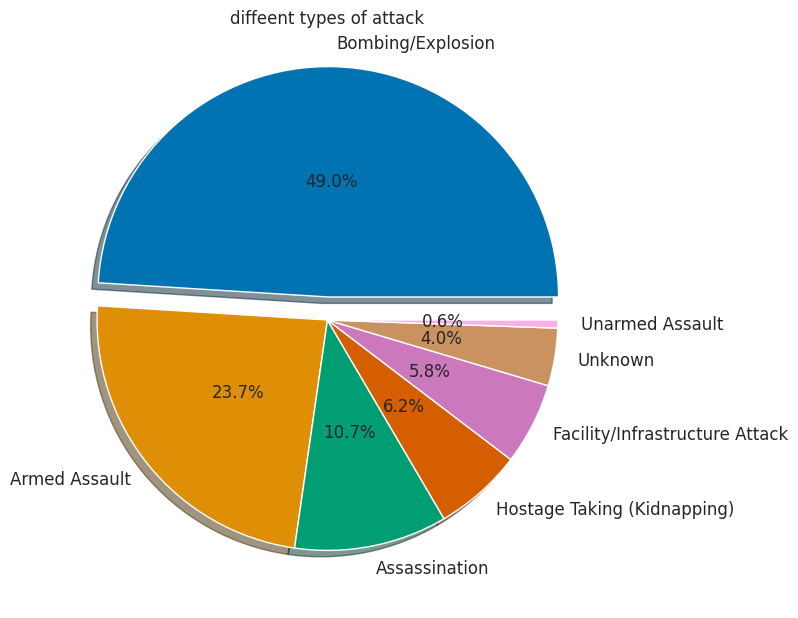

In [30]:
plt.figure(figsize = (8,8))
colors = sns.color_palette('colorblind')
explode_list =[0.1, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]

df = data['Attacktype'].value_counts().head(7)

#plotting the pie chart
plt.pie(df, labels=df.index, autopct='%1.1f%%',explode=explode_list, pctdistance=.5, colors=colors, shadow=True)

plt.title('diffeent types of attack')
plt.tight_layout()
plt.show()

## **Insights:**
From the Pie chart visualised above we get more insights on the most preferred types of attack used by terrorists, some of them are namely explosions, armed assaults, assassination, infrastructure attacks or even hijacking.

* The most preferred mode of attack by terrorists include bombing, nearly 50% of all total attacks were caused by Improvised Explosive Devices (I.E.D) or other bombs.
* The second most preferred type of attack is the Armed assault at 23.5% of total attacks.
* The third most preferred attack type is Covert Assassinations at 10.6%.

# **Terror Trend Analysis:**


### **Overall Trerror trend lineplot:**

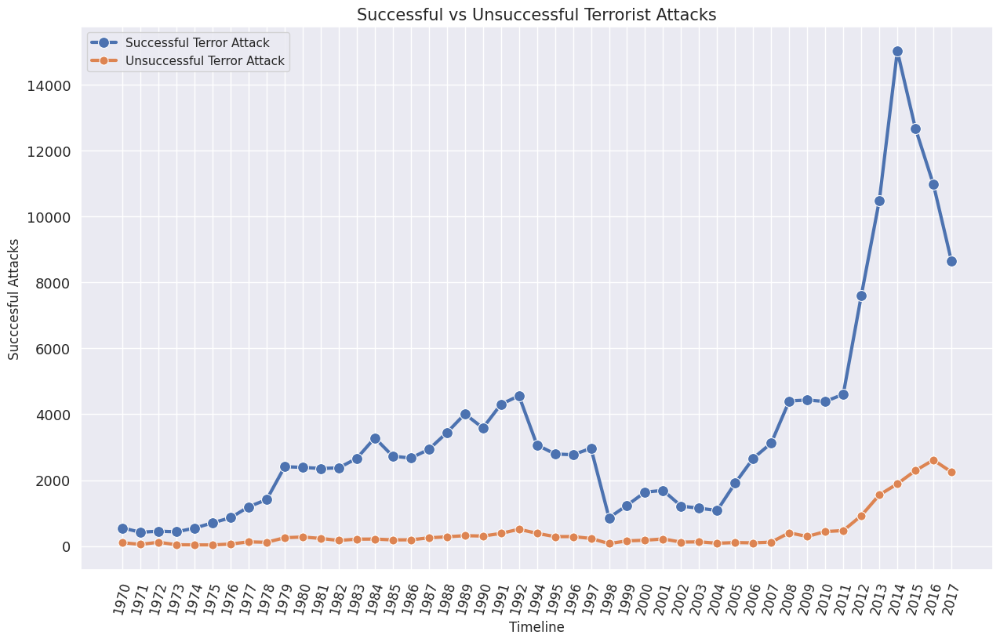

In [32]:
year_grp= data.groupby('Year')
count_year = pd.DataFrame(year_grp['success'].sum()).reset_index()
failed = data[data['success'] == 0]
failed_df = pd.DataFrame(failed['Year'].value_counts().reset_index())
failed_df.columns = ['Year','Failures']
failed_df.sort_values(by='Year', ascending = True, inplace = True)


# line plot to represent year vs no. of attacks
plt.figure(figsize = (15,9))
sns.lineplot(data = count_year, x=count_year['Year'].astype(str), y= count_year['success'], linewidth = 3, label = 'Successful Terror Attack',
             marker = 'o', markersize = 10)
sns.lineplot(data = failed_df, x=failed_df['Year'].astype(str), y= failed_df['Failures'], linewidth = 3, label = 'Unsuccessful Terror Attack',
             marker = 'o', markersize = 8)
plt.ylabel('Succcesful Attacks', fontsize = 12)
plt.xlabel('Timeline', fontsize = 12)
plt.xticks(rotation=75)
plt.yticks(fontsize=13)
plt.title('Successful vs Unsuccessful Terrorist Attacks', fontsize = 15)

plt.show()







## **Insights:**
The blue plot line indicates number of successful attacks and the orange line indicates the number of unsuccessful attacks.

The following inference can be obtained from the above plot -

* From the plot above it can be understood there were two significant time periods where a tremendous increase/spike in terrorist attacks which were recorded, they were in the years 1992 and 2014.

* The least terrorist attacks were observed in the years 1973, 1998 and 2004.

* The highest number of unsuccessful attacks were recorded in the year 2016 with about 2300 attacks, However this information does not indicate an increase in success ratio of any intelligence/military agencies.

# **Target Analysis:**

In [33]:
#percentage of target types
(data['Target_type'].value_counts().head(10)/data.shape[0])*100

Private Citizens & Property       23.947801
Military                          15.401974
Police                            13.487735
Government (General)              11.713844
Business                          11.375907
Transportation                     3.742068
Utilities                          3.314969
Unknown                            3.246171
Religious Figures/Institutions     2.443709
Educational Institution            2.378764
Name: Target_type, dtype: float64

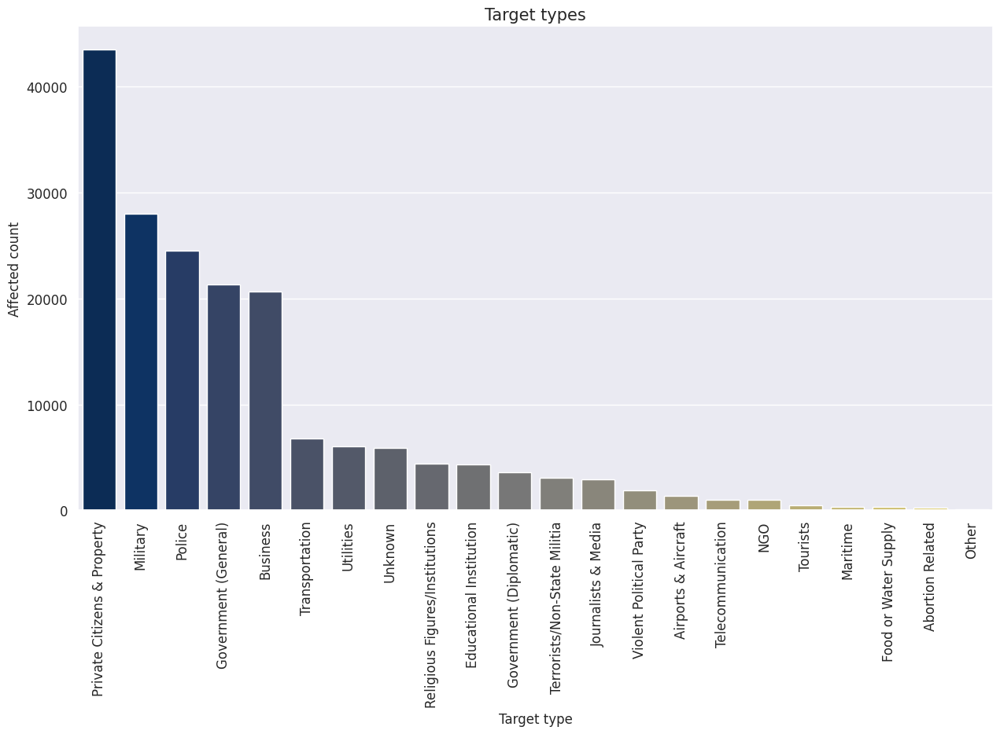

In [34]:
#visualization of percentage of target
plt.subplots(figsize=(15,8))
sns.countplot(x='Target_type', data = data, palette='cividis', order = data.Target_type.value_counts().index)

plt.title('Target types', fontsize=15)
plt.xlabel('Target type')
plt.ylabel('Affected count')

plt.xticks(rotation=90)
plt.show()

## **Insights:**
* The top five targets of terrorist attacks are citizens, the military, the police, governments, and businesses.

* The most attacked target is 'Private Citizens & Property' which is approximately over 40000 attacks.

* Military installations are the second most attacked type of asset with about 27000 attacks.

* Police installations and assets are the third most preferred asset to be attacked by terrorist organisations at 25000 attacks.

# **Weaponary Analysis:**


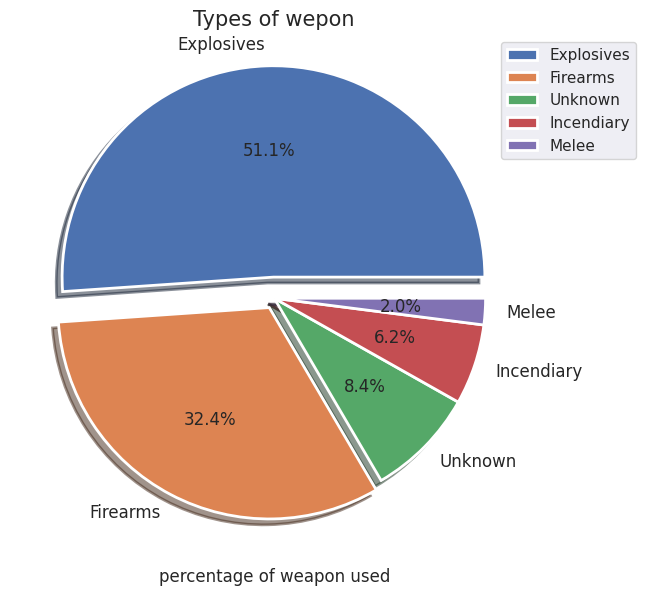

Explosives                                                                     92426
Firearms                                                                       58524
Unknown                                                                        15157
Incendiary                                                                     11135
Melee                                                                           3655
Chemical                                                                         321
Sabotage Equipment                                                               141
Vehicle (not to include vehicle-borne explosives, i.e., car or truck bombs)      136
Other                                                                            114
Biological                                                                        35
Fake Weapons                                                                      33
Radiological                                                     

In [35]:
# Most common types of weapon in terrorist attack
weaponary = data['Weapontype'].value_counts().sort_values(ascending=False)

plt.figure(figsize =(15,7))
plt.subplot(1, 2, 1)
plt.pie(weaponary.head(), labels = weaponary.head().index, autopct = '%1.1f%%', explode =(0.1,0.05,0,0,0), shadow = True, wedgeprops = {'linewidth': 2, 'edgecolor' : 'white'})
plt.title('Types of wepon', fontsize = 15)
plt.xlabel('percentage of weapon used')
plt.legend(loc = 'upper right', bbox_to_anchor = (1.2, 1.0))
plt.show()
print(weaponary)




## **Insight:**
From the Pie chart visualised above we get more insights on the most preferred types of attack used by terrorists, some of them are namely explosions, armed assaults, assassination, infrastructure attacks or even hijacking.

* The most preferred mode of attack by terrorists include bombing, nearly 50% of all total attacks were caused by Improvised Explosive Devices (I.E.D) or other bombs.
* The second most preferred type of attack is the Armed assault at 23.5% of total attacks.
* The third most preferred attack type is Covert Assassinations at 10.6%.

Explosives    29547
Firearms      25889
Unknown        6720
Incendiary     5909
Melee          1514
Name: Weapontype, dtype: int64
Explosives    62879
Firearms      32635
Unknown        8437
Incendiary     5226
Melee          2141
Name: Weapontype, dtype: int64


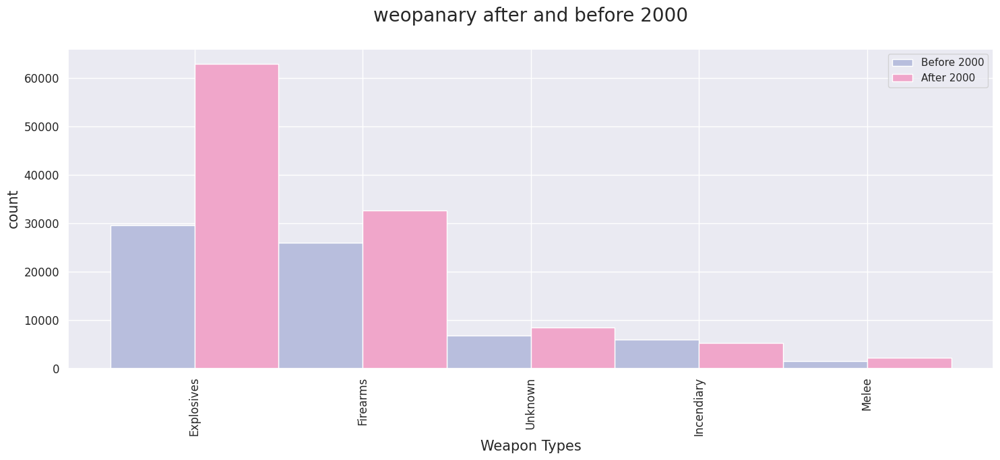

In [36]:
#impact of weaponary before and after 2000
wp_bf = data[data['Year']<2000]
wp_af = data[data['Year']>=2000]

count_bf= wp_bf['Weapontype'].value_counts().sort_values(ascending=False).head()
count_af= wp_af['Weapontype'].value_counts().sort_values(ascending=False).head()
weapon_types = count_bf.index.unique()
print(count_bf)
print(count_af)

width = 0.5

x = np.arange(len(count_bf))

plt.figure(figsize = (15, 7))
plt.bar(x - width/2, count_bf, width, label='Before 2000', color='#b8bedd')
plt.bar(x + width/2, count_af, width, label='After 2000', color='#f0a6ca')

plt.xlabel('Weapon Types', fontsize=15)
plt.ylabel('count', fontsize=15)
plt.title('weopanary after and before 2000\n', fontsize = 20)
plt.xticks(x, weapon_types, rotation = 90)
plt.legend()
plt.tight_layout()
plt.show()




## **Insight:**
* We can observe that with the advancement of the technology, the access and exploitaion of Explosives and Firearms increased significantly after year 2000.

* Explosives were used 29547 times and 25889 times Firearms were used.

* Also we can observe that 3rd group bar is Unknown or we can say we don't access to that data but it also significant growth.

* Usage of Indendiary(fire) slightly decreased after year 2000.

# **Analysis of Terror Attack in India(Uni - Variate):**

In [37]:
def change_case(text):
    text = text.lower()
    return text[0].upper()+text[1:]

In [38]:
india = data[data.Country=='India'].reset_index()
india.city = india.city.apply(change_case)
india.head()

,index,eventid,Year,month,day,extended,country,Country,region,Region,...,weapsubtype1_txt,kills,Wounds,property,ishostkid,dbsource,INT_LOG,INT_IDEO,INT_MISC,INT_ANY
0,1186,197202220004,1972,2,22,0,92,India,6,South Asia,...,Unknown Explosive Type,0.0,0.0,0,1.0,Hijacking DB,1,1,1,1
1,2764,197501190004,1975,1,2,0,92,India,6,South Asia,...,Unknown Explosive Type,4.0,0.0,0,0.0,UMD Encyclopedia of World Terrorism 2012,0,0,0,0
2,3857,197605260001,1976,5,26,0,92,India,6,South Asia,...,Unknown Explosive Type,0.0,0.0,1,0.0,PGIS,-9,-9,0,-9
3,5327,197709280004,1977,9,28,0,92,India,6,South Asia,...,Unknown Gun Type,0.0,0.0,0,1.0,Hijacking DB,1,1,1,1
4,7337,197901130004,1979,1,13,0,92,India,6,South Asia,...,Automatic or Semi-Automatic Rifle,0.0,0.0,1,0.0,PGIS,0,0,0,0


In [39]:
india.city.value_counts()

Srinagar      662
Unknown       624
Imphal        426
New delhi     158
Amritsar      142
             ... 
Golbandhi       1
Achanbigei      1
Rajhania        1
Banahi          1
Hungrum         1
Name: city, Length: 4749, dtype: int64

## **Animated Visualisation Of Terror activity in India:**

In [41]:
pip install cartopy

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.8/11.8 MB 12.7 MB/s eta 0:00:00



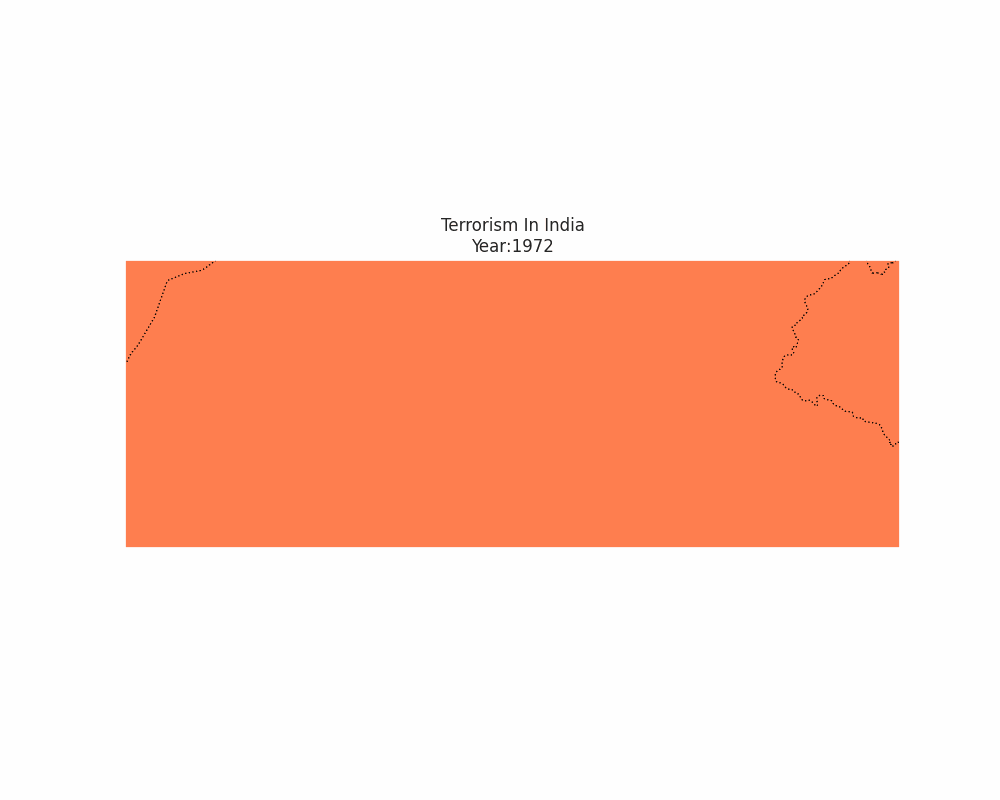

In [42]:
import matplotlib.pyplot as plt
import pandas as pd
from matplotlib import animation
import base64
import io
from IPython.display import HTML
import cartopy.crs as ccrs
import cartopy.feature as cfeature



fig = plt.figure(figsize=(10, 8))
ax = plt.axes(projection=ccrs.PlateCarree())

def animate(Year):
    ax.clear()
    ax.set_title('Terrorism In India' + '\n' + 'Year:' + str(Year))

    # Filter data for the current year
    year_data = india[india['Year'] == Year]

    # Plot the data as a scatter plot
    ax.scatter(
        year_data['longitude'], year_data['latitude'],
        s=year_data['kills'] + year_data['Wounds'],
        color='r', alpha=0.5, transform=ccrs.PlateCarree()
    )

    ax.add_feature(cfeature.COASTLINE)
    ax.add_feature(cfeature.BORDERS, linestyle=':')
    ax.add_feature(cfeature.LAND, color='coral')
    ax.add_feature(cfeature.OCEAN, color='aqua')

ani = animation.FuncAnimation(fig, animate, frames=india['Year'].unique(), interval=1500)

# Save the animation as a GIF
ani.save('animation.gif', writer='pillow', fps=1)

plt.close(fig)  # Close the figure

# Display the animation
filename = 'animation.gif'
video = io.open(filename, 'rb').read()
encoded = base64.b64encode(video).decode('ascii')
HTML(data='''<img src="data:image/gif;base64,{0}" type="gif" />'''.format(encoded))


In [43]:
# for india
india = data[data['Country'] == 'India']

#Top 10 states of india that are attacked by terrorist
state_data = india.groupby('State')['kills'].count().sort_values(ascending=False).reset_index().head(10)

#Top 10 cities of india that are attacked by terrorist
city_data = india.groupby('city')['kills'].count().sort_values(ascending=False).reset_index().head(10)
city_df = city_data.drop(axis=0, index=1)





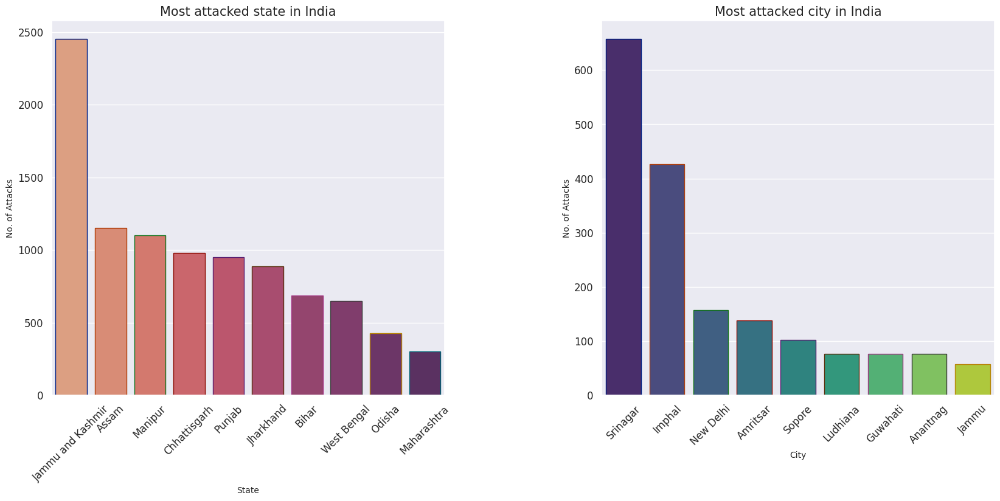

In [44]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(20, 8))  # Adjust the figure size as needed
plt.subplots_adjust(wspace=0.4)  # Adjust the horizontal spacing between subplots

# First subplot (1st column)
plt.subplot(1, 2, 1)
sns.barplot(x=state_data['State'], y=state_data['kills'], palette='flare', edgecolor=sns.color_palette('dark', 10), orient='v')
plt.title('Most attacked state in India', fontsize=15)
plt.xlabel('State', fontsize=10)
plt.ylabel('No. of Attacks', fontsize=10)
plt.xticks(rotation=45)

# Second subplot (2nd column)
plt.subplot(1, 2, 2)  # Change the subplot index to 2
sns.barplot(x=city_df['city'], y=city_df['kills'], palette='viridis', edgecolor=sns.color_palette('dark', 10), orient='v')
plt.title('Most attacked city in India', fontsize=15)
plt.xlabel('City', fontsize=10)
plt.ylabel('No. of Attacks', fontsize=10)
plt.xticks(rotation=45)

plt.show()


## **Insight:**
* 'Jammu and Kashmir' is the State in India with the most Terror attacks in followed by 'Assam' & 'Manipur'.
* 'Srinagar' is the city with most attacks in India followed by 'Imphal' & 'New Delhi'.

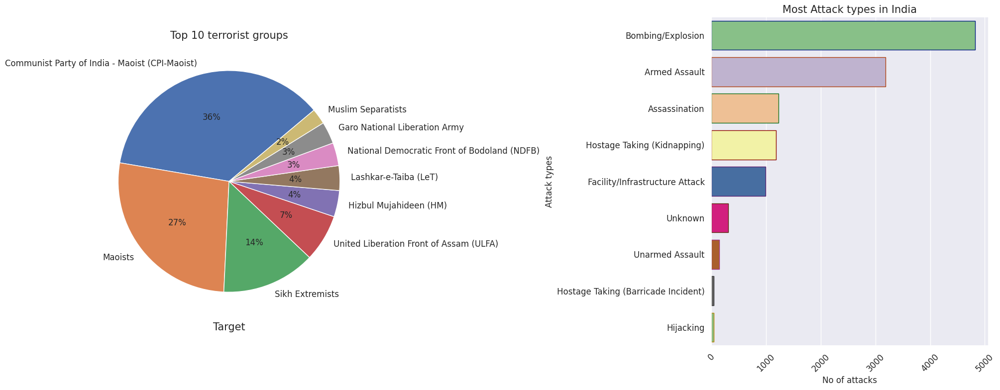

In [45]:
#Top 10 terrorist group who killed most citizens
group_data = india.groupby('Gang_name')['kills'].count().sort_values(ascending = False).reset_index().head(10)
group_df = group_data.drop(axis = 0, index =0)

# Top 10 most attacked tagets in india
attack_df = india.groupby('Attacktype')['kills'].count().sort_values(ascending = False).reset_index().head(10)


plt.figure(figsize=(20, 8))  # Adjust the figure size as needed
plt.subplots_adjust(wspace=0.5)

# visualisation for Top 10 terrorist group who killed most citizens
plt.subplot(1, 2, 1)
xlabels = group_df['Gang_name']
ylabels = group_df['kills']
plt.pie(ylabels, labels=xlabels, autopct='%.0f%%', startangle=40)
plt.title('Top 10 terrorist groups', fontsize=15)
plt.xlabel('Target', fontsize=15)

# visualisation Top 10 most attacked tagets in india
plt.subplot(1, 2, 2)
sns.barplot(x=attack_df['kills'], y=attack_df['Attacktype'], palette='Accent', edgecolor=sns.color_palette('dark', 10), orient='h')
plt.title("Most Attack types in India", fontsize=15)
plt.xlabel("No of attacks", fontsize=12)
plt.ylabel("Attack types", fontsize=12)
plt.xticks(rotation=45)

plt.tight_layout()
plt.show()

## **Insights:**
* Most dangerous terrorist group in India is Communist Party of India-Maoists(CPI-M) followed by Maoists, Sikh_Extremists & ULFA.

* The terrorists used bombs or explosions as their favourite type of attack succeeded by Armed Assault.

# **Analysis of terrorist Attacks(Bi-Variate):**

### **Analyis Of Yearwise Terrorist Attacks Stacked On Weapon Used In India**

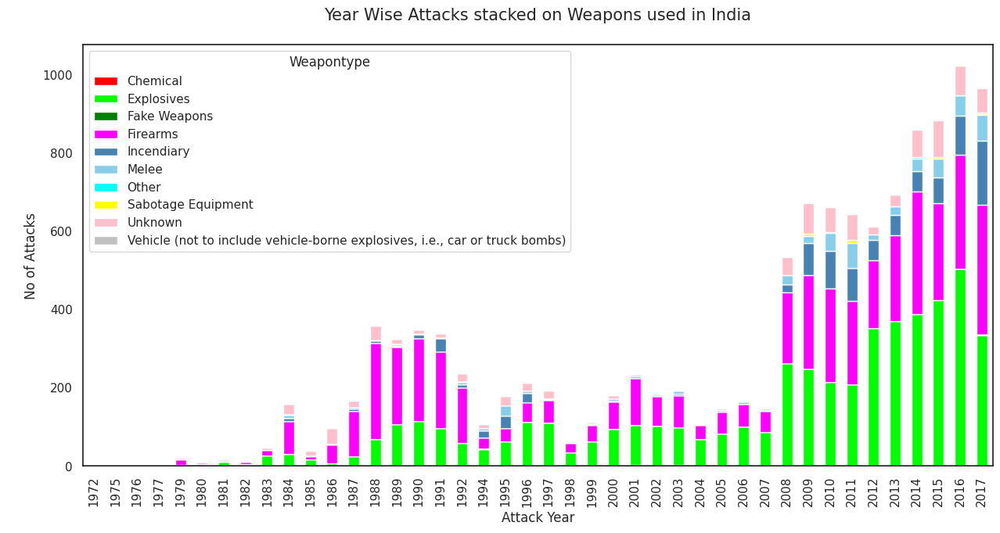

In [46]:


#Dataframe of Year wise Terror attacks in India
year_df = india.groupby(['Year','Weapontype'])['kills'].count().unstack('Weapontype').fillna(0)


#set seaborn plotting aesthetics
sns.set(style='white')

#create stacked bar chart
ax = year_df.plot(kind='bar', stacked=True, color=['red', 'lime', 'green', 'fuchsia', 'steelblue','skyblue', 'aqua', 'yellow', 'pink', 'silver'])

#rotate x-axis labels
plt.xticks(rotation=90)

#add axis titles
plt.ylabel('\nNo of Attacks',fontsize= 12)
plt.xlabel("Attack Year",fontsize= 12)

#add overall title
plt.title("Year Wise Attacks stacked on Weapons used in India\n",fontsize=15)

# Set plot size
plt.gcf().set_size_inches(15,7)

#Display the plot
plt.show()

## **Insights:**
* As per the analysis In 2016, India has suffered the maximum number of Terrorist attacks.

* There was a low number of terrorist activities till 2007, with minor spike from 1987 to 1994.

* An exponential increase was observed in activities from the year 2008 to 2017.

* Explosives and Firearms were the most prominent type of weaponry utilised by terrorists.

* We can also conclude from the stacked bargraph, that the use of Explosives instead of Firearms is increased after 1992.

* The use of Incendiaries ((of a device or attack) designed to cause fires ) is increased sharply in 2017.

# **World Wide Terror Analysis:**

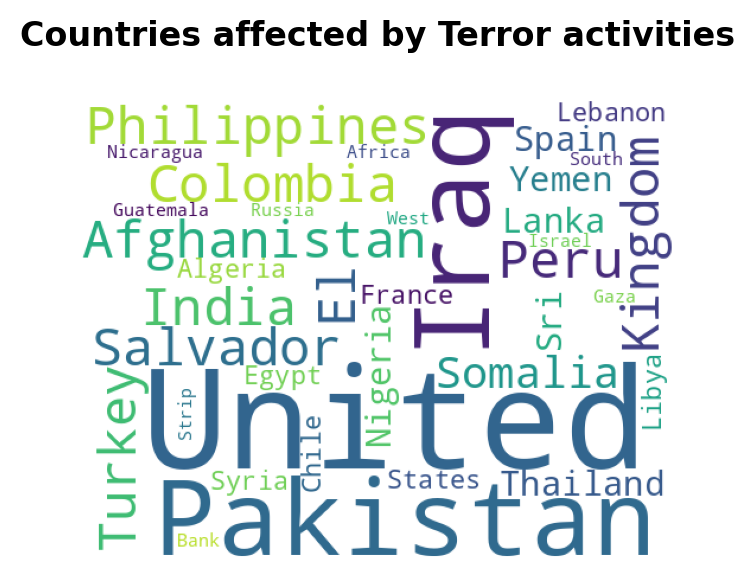

In [47]:
# word cloud for countries affected by terrorist
cities = tot_attack['Country']
plt.subplots(figsize=(4,3), dpi=200)
wordcloud = WordCloud(background_color = 'White',
                      width = 500,
                      height = 390).generate(' '.join(cities))

plt.axis('off')
plt.imshow(wordcloud)
plt.title('Countries affected by Terror activities\n',
          fontdict = {'color': 'black', 'weight': 'bold'})
plt.show()

## **Analysing the success and failure of attacks:**

In [48]:
#custom function for tabulate attacks for failure
def failure_count(num):
  if num == 0:
    return 1
  else:
    return 0


In [49]:
#Code -
var = data
attack_group_w = var[['Year','month','success','Gang_name']]

attack_group_w.insert(loc = 4, column = 'Failure',value = attack_group_w['success'].apply(failure_count))
overall = pd.pivot_table(data = attack_group_w,index = 'Gang_name',values = ['success','Failure'],aggfunc = np.sum)
overall['Total_attacks'] = overall['Failure']+overall['success']
overall['Success_rate'] = round((overall['success']/overall['Total_attacks'])*100,2)

overall_top10 = overall.nlargest(n = 11, columns= 'Total_attacks')
overall_top10 = overall_top10.drop('Unknown',axis = 0)

overall_top5 = overall_top10.nlargest(5,columns= 'Total_attacks')
top5gang = overall_top5.reset_index()['Gang_name']


In [50]:
overall_top10

,Failure,success,Total_attacks,Success_rate
Gang_name,,,,
Taliban,798,6680,7478,89.33
Islamic State of Iraq and the Levant (ISIL),854,4759,5613,84.79
Shining Path (SL),218,4337,4555,95.21
Farabundo Marti National Liberation Front (FMLN),34,3317,3351,98.99
Al-Shabaab,272,3016,3288,91.73
New People's Army (NPA),315,2457,2772,88.64
Irish Republican Army (IRA),389,2282,2671,85.44
Revolutionary Armed Forces of Colombia (FARC),185,2302,2487,92.56
Boko Haram,171,2247,2418,92.93


## **Insights:**
* The following rankings for the organisations is provided based on the number of Successful terrorist attacks committed worldwide overall.

* Taliban - With 6680 successful attacks and a success rate of 89.33%, Taliban ranks No.1 in the World as the most notorious terrorist organisation.

* Islamic State of Iraq and the Levant (ISIL) - 4759 successful attacks with a success rate of 84.79%, ISIL ranks No.2 in the world.

* Shining Path (SL) - 4337 successful attacks with a success rate of 95.21%, SL ranks No.3 in the world.

* Farabundo Marti National Liberation Front (FMLN) - 3317 successful attacks with a success rate of 98.99%, FMLN ranks No.4 in the world.

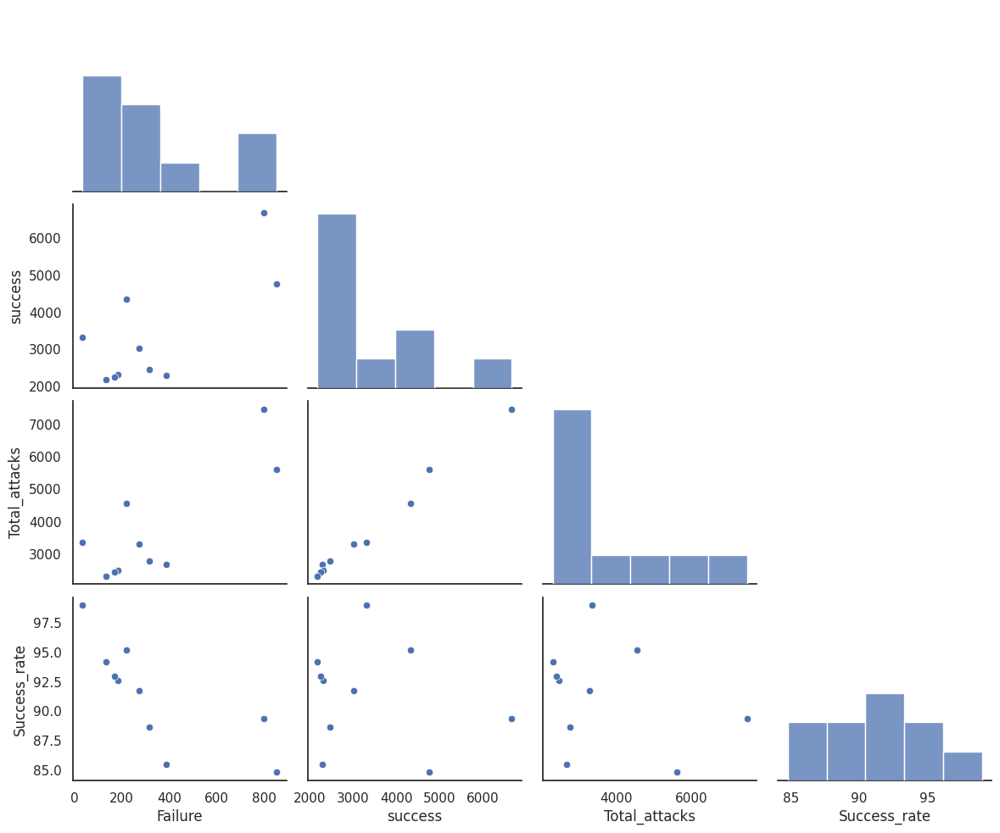

In [51]:
# PAIRPLOT for co-relationship of attributes for top 10 Terrorist organizations. -

plot_d = overall_top10.reset_index()



sns.pairplot(plot_d, corner = True,aspect = 1.2);

* From the above chart we can observe that there is a linear relationship between the successful attacks and total attacks variable series, and also the histogram of success rates is close distribution with success rates of all terrorist groups above 80%.

## **Analysis of terror groups:**

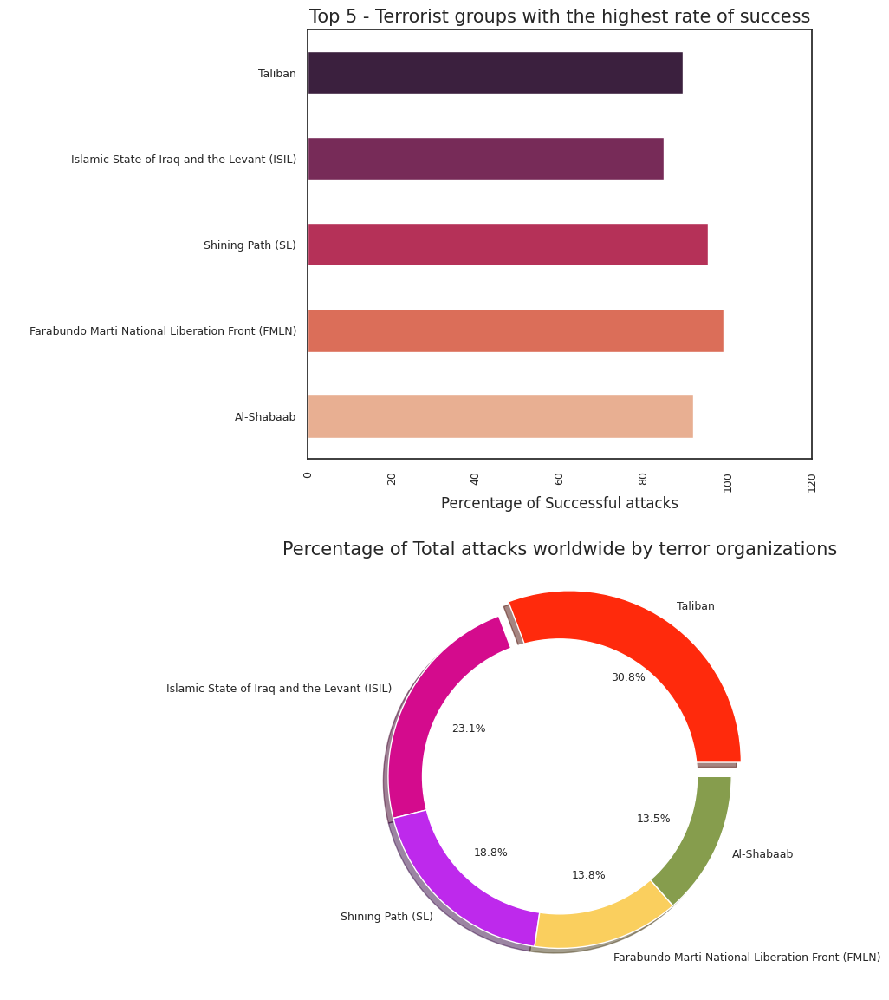

In [52]:
# Create subplots with 2 rows and 1 column
fig, axs = plt.subplots(2, 1, figsize=(10, 12))

# Bar plot
sns.barplot(data=overall_top5, x='Success_rate', y=overall_top5.index, palette='rocket', ax=axs[0], width=0.5)
axs[0].set_xticks(axs[0].get_xticks())
axs[0].set_yticks(axs[0].get_yticks())
axs[0].set_xticklabels(axs[0].get_xticklabels(), rotation=90, fontsize=9)
axs[0].set_yticklabels(axs[0].get_yticklabels(), fontsize=9)
axs[0].set_ylabel(' ')
axs[0].set_xlabel('Percentage of Successful attacks')
axs[0].set_title('Top 5 - Terrorist groups with the highest rate of success', fontsize=15)

# Pie plot
df = overall_top5['Total_attacks']
explode = (0.1, 0, 0, 0, 0)
colors = ['#ff2a0c', '#d40b8d', '#be29ec', '#facf5e', '#869d4d', '#06e4d1', '#283482', '#e6ff05', '#e1a28e', '#00a898']
axs[1].pie(df, labels=overall_top5.index, autopct='%1.1f%%', explode=explode, shadow=True, colors=colors, radius=1, textprops={'fontsize': 9})
my_circle = plt.Circle((0, 0), 0.8, color='white')
axs[1].add_artist(my_circle)
axs[1].set_title("Percentage of Total attacks worldwide by terror organizations", fontsize=15)

# Adjust spacing between subplots
plt.tight_layout(pad=2, w_pad=4)

# Display the subplots
plt.show()

## **Insight:**
We can observe that -

* Taliban - has carried out 30.8% of the total terrorist attacks in the world, with a success rate of 89.33%.

* Islamic State of Iraq and the Levant (ISIL) - has carried out 23.1% of the total terrorist attacks in the world, with a success rate of 84.79%.

* Shining Path (SL) - has carried out 18.8% of the total terrorist attacks in the world, with a success rate of 95.21%.

* Farabundo Marti National Liberation Front (FMLN) - has carried out 13.8% of the total terrorist attacks in the world, with a success rate of 98.99%.

* AL-Shabaab - has carried out 13.5% of the total terrorist attacks in the world, with a success rate of 91.73%.

In [53]:
#year wise terror group analysis
#Code -
overall2 = pd.pivot_table(data = attack_group_w,index = ['Gang_name','Year'],values = ['success','Failure'],aggfunc = np.sum)
overall2.reset_index()
overall2.sort_values(by = 'Year',ascending = True, inplace = True)
overall2['Total_attacks'] = overall2['Failure']+overall2['success']
overall2['Success_rate'] = round((overall2['success']/overall2['Total_attacks'])*100,2)
overall2.sort_values(by = 'Total_attacks', ascending = False, inplace = True)
overall2 = overall2.reset_index()
overall2 = overall2[overall2['Gang_name'].isin(top5gang)]
overall2.sort_values(by = 'Year', ascending = True, inplace = True)

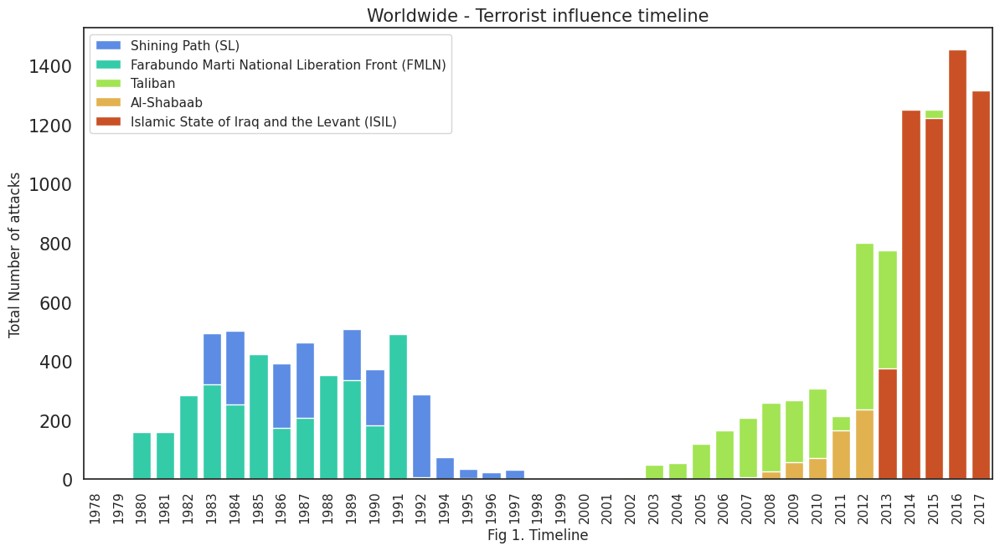

<Figure size 4000x600 with 0 Axes>

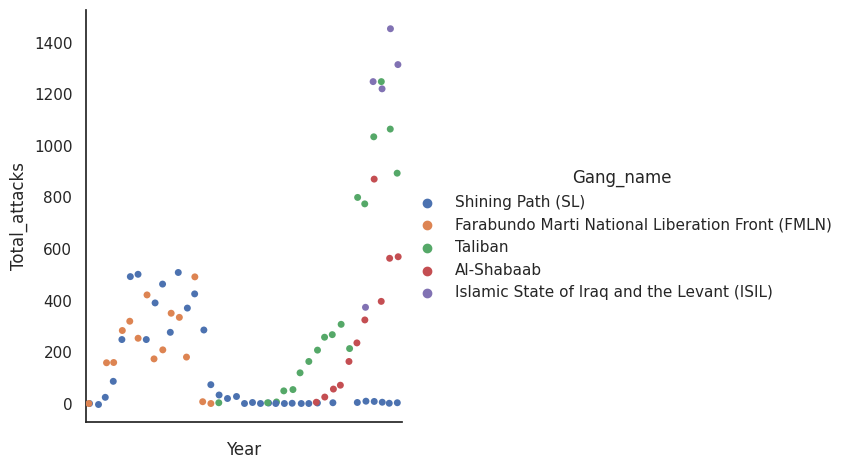

In [54]:
#Visualisation -

#Barplot code -
plt.figure(figsize = (14,7))
sns.barplot(data = overall2, x = 'Year',y ='Total_attacks', hue = 'Gang_name', dodge = False, palette = 'turbo')
plt.legend(bbox_to_anchor = (1,1),fontsize =22)
plt.xticks(rotation = 90)
plt.yticks(fontsize = 15)
plt.title('Worldwide - Terrorist influence timeline',fontsize = 15)
plt.ylabel('Total Number of attacks', fontsize = 12)
plt.xlabel('Fig 1. Timeline',fontsize =12)
plt.legend(loc='upper left')

plt.show()


#Catplot -
plt.figure(figsize = (40,6))
ax = sns.catplot(data = overall2, x = 'Year', y = 'Total_attacks', hue = 'Gang_name')
plt.xticks(rotation = 90)
ax.set(xticklabels=[])
plt.show()

## **Insight:**
We can observe that -

* During the time period from 1980 - 1992 Farabundo Marti National Liberation Front (FMLN) and Shining Path (SL) Terrorised the planet with approximately 400 attacks every year.

* From 1994 to 2002 saw a decline in FMLN and SL terror activities making the number of attakcs almost negligible, although the reason behind the same could not be established from the dataset provided.

* 2002 - 2003 witnessed the entrant of the Terror organisation Taliban who quickly rose to make their mark by exponentially increasing the terror activities around the globe with about 6680 successful terror strikes.

* 2013 saw the entrant of the Terror outfit Islamic State of Iraq and the Levant (ISIL) who engaged in multiple terror strikes across the globe, with about 4759 successful terror strikes in a short time period between 2013 and 2017 and a success rate of 84.79%,

In Conclusion, By the current witnessed historic data for the time-period 1970 to 2017, Taliban* is the most notorious terrorist organisation.*

However, Based on the analytics if the same rate ensued ISIL* could quickly become the N0.1 Terror organisation in the world.*

# **Chornological events from 1970 - 2017**

In [55]:

#Using Plotly Choropleth -

attacks_time_lapse = pd.DataFrame(data.groupby(["Year" , "Country"])["Year"].count() ,
                                  columns = ["Year"]).rename(columns = {"Year" : "attacks"}).reset_index()

attacks_time_lapse_choropleth = px.choropleth(attacks_time_lapse , locations = "Country" , locationmode = "country names" ,
              color = "attacks" , animation_group = "attacks" ,
              animation_frame = "Year" , labels={"attacks" : "Number of Attacks"} ,
              title = "Number of Terror Attacks in Different Countries from 1970-2014")
attacks_time_lapse_choropleth.show()

# **Conclusion:**
Concluding the exploratory data analysis on global terrorism spanning the years 1970 to 2017, several key insights and conclusions can be drawn from the comprehensive examination of the data:

1. **Increasing Trend:** The data clearly illustrates a concerning trend of increasing global terrorism incidents over the past few decades. This upward trajectory underscores the urgent need for proactive global security measures and concerted efforts to address this issue.

2. **Geographical Distribution:** Terrorism is a global issue that transcends geographical boundaries. While certain regions, such as the Middle East, South Asia, and Sub-Saharan Africa, have witnessed a higher concentration of terrorist activities, it is essential to acknowledge that acts of terrorism have occurred in diverse countries and across multiple continents.
3. **Casualty Trends:** The impact of terrorism extends beyond property damage and governmental institutions, profoundly affecting societies and individuals. The data reveals that, between 1972 and 2017, an alarming number of people were killed or injured due to terrorist incidents, with an estimated death toll of approximately 400,000. Countries like Iraq and Afghanistan experienced a disproportionate share of these casualties.

4. **Weaponry Trends:** An in-depth analysis uncovered that explosives and firearms are the predominant weapons of choice in terrorist attacks, accounting for approximately 83% of incidents. Moreover, the data reveals a notable increase, approximately 50%, in the utilization of explosives over the last two decades, possibly reflecting advancements in technology and increased access to such weaponry.

5. **Preferred Attack Types:** The preferred method of attack employed by terrorists is bombings or explosions, constituting nearly half (48.6%) of all recorded incidents. This is followed by armed assaults (23.5%) and assassinations (10.6%).

6. **Peak Terror Events:** Notable peaks in terrorist activities occurred in the years 1992 and 2014, warranting further demographic analysis to better understand the contributing factors to these spikes.
7. **Effect on Different Nationalities:** The analysis underscores that Iraqi citizens have been most profoundly affected by terrorism. Iraq has experienced a disproportionately high number of bombings and explosions in comparison to other nations. It is worth noting that both Indian and American citizens have faced threats such as kidnapping or being taken as hostages.

8. **Target Analysis:** "Private Citizens & Property" emerge as the most frequently targeted group, representing approximately 25% of all attacks. Military, police, government, and business entities are also common targets, with attack frequencies ranging from 10% to 20%. These findings emphasize the heightened risk to civilian populations.

9. **Most Deadly Terror Organizations:** An examination of the data reveals insights into the most lethal terrorist organizations worldwide, with rankings based on the percentage of attacks and their success rates.

10. **Most Attacked Cities:** The analysis identifies the cities most frequently targeted by terrorist groups on a global scale.
11. **Terrorism in India:** The examination of terrorism in India highlights states like "Jammu and Kashmir," "Assam," and "Manipur" as the regions most impacted by terror attacks. Notably, the Communist Party of India-Maoists (CPI-M) and Maoists are identified as the most dangerous terrorist groups operating in India. Explosives and armed assaults are the preferred methods of attack, with 2016 marking a year with a significant number of terrorist incidents in India.

Lastly, we can say that a Strong security should be given for the countries like Iraq, Pakistan, Afghanistan & India and also for Middle East Regions and cities like Bhagdad, Karachi and many others. Safety measures have to be take regarding explosive devices as bombing explosions are the most notorious attack type used by terrorists.A Strong security is also needed to Private citizens and Property, Military,Police etc as they are main target in terrorism